In [26]:
% pwd
import pdb
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

layer_names = ['conv1/7x7_s2', 'pool1/2x2_s2', 'conv2/3x3_s1', 'pool2/2x2_s2', 'conv3/1x1_s1', 'conv4/3x3_s1', 'conv5/1x1_s1','conv6/3x3_s1',   
'pool3/2x2_s2', 'conv7/1x1_s1', 'conv8/3x3_s1', 'conv9/1x1_s1', 'conv10/3x3_s1','conv11/1x1_s1','conv12/3x3_s1', 'conv13/1x1_s1','conv14/3x3_s1',  
'conv15/1x1_s1','conv16/3x3_s1','pool4/2x2_s2', 'conv17/1x1_s1','conv18/3x3_s1','conv19/1x1_s1','conv20/3x3_s1',
'conv21/3x3_s1','conv22/3x3_s2', 'conv23/3x3_s1', 'conv24/3x3_s1',   'dense1','dropout','dense2']

voc_name = ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair',
             'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant',
             'sheep', 'sofa', 'train', 'tvmonitor']

In [7]:
#THEANO_FLAGS='lib.cnmem=1'
THEANO_FLAGS='floatX=float32, optimizer=None, exception_verbosity=high'
import theano
import theano.tensor as T

import pickle
with open('YOLO_FT_YT_weights.pkl', 'rb') as f:    
    net = pickle.load(f)
    
import lasagne
from lasagne.utils import floatX 

RNN_TYPE = 2 # 0 = RNN, 1 = LSTM, 2 = GRU
N_LAYER = 2
N_HIDDEN = 150
SEQ_LEN  =  30 
GRAD_CLIP = 100
BATCH_SIZE = 128 
LEARNING_RATE = 0.01
FEAT_SIZE = 1470

num_epochs = 80

#########################
test_overfit = 0 ## same input, so arbitrary artifical sequence-length possible
binary_mask_for_conf = 0 ## binary mask - consider only those grid cells, where the confidence is higher than a threshold

In [8]:
import io
import skimage.transform
import matplotlib.pyplot as plt

%matplotlib inline

import urllib

index = urllib.urlopen('http://www.image-net.org/challenges/LSVRC/2012/ori_urls/indexval.html').read()
image_urls = index.split('<br>')

np.random.seed(23)
np.random.shuffle(image_urls)
#image_urls = image_urls[:5]
image_urls = image_urls[:5]

def prep_image(url):
    ext = url.split('.')[-1]
    im = plt.imread(io.BytesIO(urllib.urlopen(url).read()), ext)
    # Resize so smallest dim = 448, preserving aspect ratio
    h, w, _ = im.shape   
    if h < w:
        im = skimage.transform.resize(im, (448, w*448/h), preserve_range=True)
    else:
        im = skimage.transform.resize(im, (h*448/w, 448), preserve_range=True)

    # Central crop to 448x448
    h, w, c = im.shape
    im = im[h//2-224:h//2+224, w//2-224:w//2+224]
    
    rawim = np.copy(im).astype('uint8')
       
    im = im/255 
    # Shuffle axes to c01
    im = np.swapaxes(np.swapaxes(im, 1, 2), 0, 1)
    
    # Convert to BGR
    im = im[::-1, :, :]  ### chck if this is necessry

    return rawim, floatX(im[np.newaxis])


def prep_image_from_name(name, ext):
    im = plt.imread(name, ext)
    # Resize so smallest dim = 448, preserving aspect ratio
    h, w, c = im.shape  
    im = skimage.transform.resize(im, (448, 448), preserve_range=True)
    
    rawim = np.copy(im).astype('uint8')
       
    im = im/255 
    # Shuffle axes to c01
    im = np.swapaxes(np.swapaxes(im, 1, 2), 0, 1)
    
    # Convert to BGR
    im = im[::-1, :, :] 

    return rawim, floatX(im[np.newaxis])


In [390]:
def convert_YOLO_det(predictions, classes, num, thresh, side, square, only_objectness):
    per_grid_params = num*5 + classes   
    all_grids = side * side
    
    my_boxes_list = []    
    label_list = []
        
    probs = np.ndarray((all_grids * num, classes), dtype='float32')
   
    box_num = 0       
    for i in range(all_grids):             
        row = i / side
        col = i % side
                
        for n in range(num):
            index = i*num + n
            p_index = all_grids*classes + i*num + n
            scale = predictions[p_index][0]
                                                 
            box_index = all_grids*(classes + num) + (i*num + n) * 4
            
            w = pow(predictions[box_index + 2][0], 2) if (square == 1) else predictions[box_index + 2][0]
            h = pow(predictions[box_index + 3][0], 2) if (square == 1) else predictions[box_index + 3][0]
            
            my_boxes_list.append({"cx": (predictions[box_index + 0][0] + col) / side , 
                                  "cy": (predictions[box_index + 1][0] + row) / side ,
                                  "w" : w,
                                  "h" : h          
                                  }
                                )
            
            for j in range (classes):
                class_index = i*classes
                prob = scale*predictions[class_index + j][0]               
                prob = prob if (prob >= thresh) else 0
                                                
                probs[index][j] = prob
            
            if (only_objectness):
                probs[index][0] = scale;
    
    return my_boxes_list, probs

#####################################################################################

def draw_detection_bbox(all_grids, probs, boxes, classes, num, w, h, thresh):
    draw_box_list = []
    
    for grid_idx in range(all_grids):        
        arg_array = np.argsort(probs[grid_idx])        
        category = arg_array[-1]               
        prob = probs[grid_idx][category]

        if (prob > thresh):
            box = boxes[grid_idx]  

            left =  (box['cx'] - box['w'] / 2.) * w
            right = (box['cx'] + box['w'] / 2.) * w
            top =   (box['cy'] - box['h'] / 2.) * h
            bot =   (box['cy'] + box['h'] / 2.) * h

            if (left  < 0):
                left = 0
            if ( right > w - 1):
                right = w - 1
            if (top < 0):
                top = 0
            if ( bot > h - 1):
                bot = h -1

            draw_box_list.append({"left": left, 
                             "top":  top,
                             "right" : right,
                             "bottom" : bot,
                             "confidence" : prob,
                             "category" : category
                             }
                            )
    
    return draw_box_list


In [10]:
################################
def det_detection_truth(featmap_index, data_list, batch, training = True, val = False ):
    import pickle
    classes = 20
    coord = 4
    side = 7
    all_grids = side * side
    elems_per_grid = 1+coord+classes
    
    if(training):
        with open('Y_train_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
            Y_labels = pickle.load(f)   #print Y_labels
    elif (val):
        with open('Y_train_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
            Y_labels = pickle.load(f)   #print Y_labels
    else:
        with open('Y_test_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
            Y_labels = pickle.load(f)   #print Y_labels
        
    Y_mb = np.ndarray( (len(batch), (all_grids*elems_per_grid)), dtype='float32')  #1470
    
    count = 0
    for i in batch:               
        ## file name to feature map index through dictionary        
        key_name = data_list[i]['GT_im_name']                
        ft_idx = featmap_index[key_name]                                               
        Y_mb[count, :] = Y_labels[ft_idx, :]   #print np.sum(Y_train_mb[count])
                
        count +=1

    return Y_mb


In [11]:
def calc_iou(boxa, boxb):
    si = 0
    dx = min([boxa[2], boxb[2]]) - max([boxa[0],boxb[0]])
    dy = min([boxa[3], boxb[3]]) - max([boxa[1],boxb[1]])
    
    if (dx > 0 ) & (dy > 0): 
        si = dx * dy              
    
    sa = boxa[4]
    sb = boxb[4]
    su = sa + sb - si
    iou = si/su
    
    rmse = np.sqrt( (boxa[0]-boxb[0])**2 + 
                   (boxa[1]-boxb[1])**2 +
                   (boxa[2]-boxb[2])**2 +
                   (boxa[3]-boxb[3])**2
                  )
    
    return iou, rmse

###########################################
def detect_accuracy(x_pred_mb, y_label_mb):
    import pdb
    side = 7
    classes = 20
    coord = 4
    all_grids = side * side
    nb = 2
    conf_thresh = 0.1
    iou_det_thresh = 0.5
        
    is_obj = np.zeros((y_label_mb.shape[0], all_grids), dtype='int')
    f_boxes = np.zeros((coord + 1), dtype='float32')
    s_boxes = np.zeros((coord + 1), dtype='float32')
    
    det_cases = np.zeros((y_label_mb.shape[0], 20), dtype='int')
    gt_cases = np.zeros((y_label_mb.shape[0], 20), dtype='int')
    
    factor = 400 #500 #400 
        
    for k in np.arange(y_label_mb.shape[0]):
        c_gt_nums = 0        
        gt_boxes = []
        
        det_nums = 0
        det_boxes = []
        for i in np.arange(all_grids):
            truth_index = i * (1 + coord + classes)
            is_obj[k,i] = y_label_mb[k,truth_index] 
            class_conditional_index = np.arange(i*classes, (i+1)*classes )
            from_index_cls = np.arange(truth_index+1, truth_index+1+classes)
            
            row = i / side
            col = i % side
            
            t_coord = truth_index+1+classes
            from_index  = np.arange(t_coord, t_coord+coord )        
            ##calc best IOU for determining "responsible" BB in every grid                                    
            if(is_obj[k,i]):
                c_gt_nums += 1
                ## GT category for this grid
                arg_array = np.argsort(y_label_mb[k,from_index_cls])  
                gt_cat = arg_array[-1]
                gt_cases[k, gt_cat] += 1

                gt_box = [ factor*(y_label_mb[k,from_index[0]] + col)/side,
                      factor*(y_label_mb[k,from_index[1]] + row) /side,
                      factor* y_label_mb[k,from_index[2]]*y_label_mb[k,from_index[2]] *factor,
                      factor* y_label_mb[k,from_index[3]]*y_label_mb[k,from_index[3]] *factor,
                      gt_cat    
                     ]
                gt_box = [gt_box[0] - gt_box[2]/2,
                      gt_box[1] - gt_box[3]/2,
                      gt_box[0] + gt_box[2]/2,
                      gt_box[1] + gt_box[3]/2,
                      gt_box[2] * gt_box[3],
                      gt_cat    
                     ]                 
                gt_boxes.append(gt_box)
                                
                
            test_cat = np.argmax(x_pred_mb[k,class_conditional_index]) 
            cat_conf = np.amax(x_pred_mb[k,class_conditional_index])   #x_pred_mb[k,test_cat]
                                            
            bb_idx = 0            
            sc = all_grids*classes + i*nb 
            max_val = x_pred_mb[k, sc]               
            if(x_pred_mb[k, sc+1]  > max_val):
                max_val = x_pred_mb[k, sc+1]
                bb_idx = 1
               
            if ( max_val * cat_conf >  conf_thresh):
                ## debug : correct confidence score
                #print max_val * cat_conf

                s = all_grids*classes + nb*all_grids + i*nb*coord + bb_idx*coord
                coord_index = np.arange( s, s+coord )  

                det_box = [ factor*(x_pred_mb[k,coord_index[0]] + col)/side,
                      factor*(x_pred_mb[k,coord_index[1]] + row)/ side,
                      factor*x_pred_mb[k,coord_index[2]]*x_pred_mb[k,coord_index[2]]*factor,
                      factor*x_pred_mb[k,coord_index[3]]*x_pred_mb[k,coord_index[3]]*factor,
                       test_cat
                     ]
                det_box = [det_box[0] - det_box[2]/2,
                      det_box[1] - det_box[3]/2,
                      det_box[0] + det_box[2]/2,
                      det_box[1] + det_box[3]/2,
                      det_box[2] * det_box[3],
                      test_cat    
                     ]                 
                det_boxes.append(det_box) 
        
        # end of all grids processing for one example        
        det_cases[k,:] = detections_eval(gt_boxes, det_boxes, iou_det_thresh, k) 
        
    # end all the mini-batch processing    
    return np.sum(det_cases, axis=0) , np.sum(gt_cases, axis=0) 
    #return det_cases, gt_cases 




def detections_eval(boxa, boxb, iou_det_thresh, k):
    gt_num = len(boxa)
    det_num = len(boxb)
    det_cases_curr = np.zeros((1,20), dtype = 'int')
    gt_flags = np.zeros(gt_num, dtype='int')
    
    for i in range(gt_num):
        gt_box = boxa[i]        
       
        for j in range(det_num):
            test_box = boxb[j]
            
            si = 0
            dx = min([gt_box[2], test_box[2]]) - max( [gt_box[0], test_box[0]] )
            dy = min([gt_box[3], test_box[3]]) - max( [gt_box[1], test_box[1]] )
            
            if (dx > 0 ) & (dy > 0):
                si = dx * dy

            sa = gt_box[4]
            sb = test_box[4]
            su = sa + sb - si
            iou = si/su
            
            if(gt_flags[i] == 0):
                if( test_box[5] == gt_box[5]): # same category
                    #print 'matched category' 
                    #print iou                
                    if( (iou > iou_det_thresh)):
                        #print iou
                        det_cases_curr[0, test_box[5]] += 1                    
                        gt_flags[i] = 1
    
    #print np.transpose(det_cases)        
    return det_cases_curr


In [12]:
def get_data_pairs_list(training = True ):
    import scipy.io
    import pdb
    import os
    
    data_pairs_list = []    
    featmap_index = {}  # as a dictionary so that can access by key
    
    count = 0 
    cat = 0
    base_gt_folder = 'Youtube/GroundTruth'
    for cat_name in voc_name:
        cat_folder = base_gt_folder + '/' + cat_name

        if os.path.isdir(cat_folder) :            
            if(training):
                gt_file_name = cat_folder + '/bb_gtTraining_' + cat_name +'.mat'  
                gt = scipy.io.loadmat(gt_file_name, struct_as_record=True)['bb_gtTraining'] 
            else:
                gt_file_name = cat_folder + '/bb_gtTest_' + cat_name +'.mat'
                gt = scipy.io.loadmat(gt_file_name, struct_as_record=True)['bb_gtTest'] 
                                  
            im_names = gt['im']
            boxes = gt['boxes']
            
            
            for l in range(0, im_names.shape[1]):  # number of images in that category                            
                data_pairs_list.append( {"cat_type" : cat_name,
                                        "category_num": cat,
                                        "frame_num": im_names[0,l][0][-8:],
                                        "boxes_num": boxes[0,l].shape[0],
                                        "boxes_coord": boxes[0,l],
                                        "GT_im_name":str(im_names[0,l][0])
                                         }
                                      ) 
                key_name = str(im_names[0,l][0])
                
                featmap_index.update({key_name: count})     #featmap_index.append({key_name: count})                 
                count += 1
                
        cat += 1        
            
    return data_pairs_list, featmap_index


def iterate_detection_minibatches(input_batch, batch_size, shuffle=False):
    import numpy as np
       
    if shuffle:
        indices = np.arange(len(input_batch))
        np.random.shuffle(indices)
        
    for start_idx in range(0, len(input_batch) - batch_size + 1, batch_size ):
        if shuffle:
            excerpt = indices[start_idx:start_idx + batch_size]
            
        else:
            excerpt = slice(start_idx, start_idx + batch_size)    
            
        
        yield input_batch[excerpt]
       
               

In [13]:
def write_labels(entry, featmap_index, training = True):    
    import pdb    
    import numpy as np
    
    classes = 20
    side = 7
    all_grids = side * side
    
    my_boxes_list = []    
    label_list = []
    elems_per_grid = 1+ 4 + classes
    
    Y_labels = np.ndarray( ( len(entry), all_grids*elems_per_grid), dtype='float32')    
    truth_vec = np.zeros( (1, (all_grids*elems_per_grid)), dtype='float32') 
    
    if(training):
        base_lb_folder = 'Youtube/labels/'
    else:
        base_lb_folder = 'Youtube/test_labels/'
    
    for img_nb in range(len(entry)):
        truth_vec.fill(0)
        category = entry[img_nb]['category_num']  
        
        ## file name to feature map index through dictionary        
        key_name = entry[img_nb]['GT_im_name']                
        ft_idx = featmap_index[key_name]  
               
        tmp = "%06d.txt" % (ft_idx + 1)
        label_file = base_lb_folder + tmp
         
        with open(label_file) as f:
            for line in f:               #lines = f.read().split('\n')                           
                elems = line.split(' ')        
                class_id = int(elems[0]) - 1
              
                cx = float(elems[1])
                cy = float(elems[2])
                
                col = float(cx) * side                                           
                col = int(np.clip(col, 0, side - 1))            
                row = float(cy) * side
                row = int(np.clip(row, 0, side - 1))
                                                           
                index = row * side * elems_per_grid + col*elems_per_grid                 #print index
                truth_vec[0,index] = 1
                                               
                index += 1
                truth_vec[0,index + (class_id)] = 1
                
                cx = cx*side - col
                cy = cy*side - row
                
                w = float(elems[3])
                h = float(elems[4])
                w = np.sqrt(w)
                h = np.sqrt(h)
                                
                index += classes
                truth_vec[0,index]     = cx
                truth_vec[0,index + 1] = cy
                truth_vec[0,index + 2] = w
                truth_vec[0,index + 3] = h
                
        Y_labels[img_nb,:] = truth_vec
        
        
    if(training):
        with open('Y_train_labels.pkl', 'wb') as f:    
            pickle.dump(Y_labels,f, -1)
    else:
        with open('Y_test_labels.pkl', 'wb') as f:    
            pickle.dump(Y_labels,f, -1)
             
    
    return Y_labels


####################################################
def create_compatible_label_masks(x_features_mb, y_label_mb):     
    #x_pred_mb = np.matrix(lasagne.layers.get_output(rnet['obj_det_output'], [x_features_mb ], deterministic=True).eval())
    x_pred_mb = x_features_mb
    
    in_shape = x_pred_mb.shape     
    propagated_target = np.zeros((y_label_mb.shape[0], FEAT_SIZE), dtype='float32') ## prediction size = 1470
    wgt_mask          = np.zeros( (in_shape), dtype='float32') ## prediction size = 1470
    
    l_coord = 5.
    l_noobj = 0.5
    l_default = 1.
    side = 7
    classes = 20
    coord = 4
    all_grids = side * side
    nb = 2
    rmse_thresh = 20
    
    f_boxes = np.zeros((coord + 1), dtype='float32')
    s_boxes = np.zeros((coord + 1), dtype='float32')
    factor = 400 #
     
    ## arrangement order
    ## class conditionals for all grids, scores for all BBs in all grids, coords of all BBs in all grids       
    for i in range(0, all_grids):
        row = i / side
        col = i % side
        
        s = all_grids*classes + nb*all_grids + i*nb*coord 
        coord_index = np.arange( s, s+coord )    
        sc = all_grids*classes + i*nb ## score of first BB for that grid
        
        truth_index = i * (1 + coord + classes)        
        class_conditional_index = np.arange(i*classes, (i+1)*classes )
        from_index_cls = np.arange(truth_index+1, truth_index+1+classes)

        t_coord = truth_index+1+classes
        from_index_coord  = np.arange(t_coord, t_coord+coord )  
        
        for k in range(y_label_mb.shape[0]):             
            if (y_label_mb[k,truth_index] == 0):
                wgt_mask[k, classes*all_grids + i*nb + 0] = l_noobj  # weights for confidence if object not present 
                wgt_mask[k, classes*all_grids + i*nb + 1] = l_noobj  # weights for confidence if object not present 
            else:
                wgt_mask[k, classes*all_grids + i*nb + 0] = l_default  # weights for confidence if object present 
                wgt_mask[k, classes*all_grids + i*nb + 1] = l_default  # weights for confidence if object present                 
                wgt_mask[k,class_conditional_index] = l_default  ## non-zero weights for class conditionals only if objects present
            
            propagated_target[k,class_conditional_index] = y_label_mb[k,from_index_cls]  ## class conditionals
                        
            ### masks will be non-zero if obj_present in that grid; otherwise no effect on cost
            if (y_label_mb[k,truth_index] == 1):                 
                gt_box = [ factor *(y_label_mb[k,from_index_coord[0]]+ col )/ side,
                      factor *(y_label_mb[k,from_index_coord[1]] + row)/side,
                      factor * y_label_mb[k,from_index_coord[2]]*y_label_mb[k,from_index_coord[2]] *factor,
                      factor * y_label_mb[k,from_index_coord[3]]*y_label_mb[k,from_index_coord[3]] *factor
                     ]
                gt_box = [gt_box[0] - gt_box[2]/2,
                      gt_box[1] - gt_box[3]/2,
                      gt_box[0] + gt_box[2]/2,
                      gt_box[1] + gt_box[3]/2,
                      gt_box[2] * gt_box[3]
                     ]
            
                ##calc best IOU for determining "responsible" BB in every grid 
                for j in range(0,nb):
                    s = all_grids*classes + nb*all_grids + i*nb*coord + j*coord
                    coord_index = np.arange( s, s+coord )                       
                    sc = all_grids*classes + i*nb + j                     

                    propagated_target[k,coord_index] = y_label_mb[k,from_index_coord]  ## Box coordinates

                    sc = all_grids*classes + i*nb + j
                    if (y_label_mb[k,truth_index] != 0):  ## is_obj True 
                        propagated_target[k,sc] = 1   #object present so, gt has full confidence (1)
                        if j == 0:
                            f_boxes = [ factor *(x_pred_mb[k,coord_index[0]] + col)/side,
                                      factor *(x_pred_mb[k,coord_index[1]]+row)/side,
                                      factor *x_pred_mb[k,coord_index[2]]*x_pred_mb[k,coord_index[2]] *factor,
                                      factor *x_pred_mb[k,coord_index[3]]*x_pred_mb[k,coord_index[3]] *factor                         
                                     ]
                            f_boxes = [ f_boxes[0] - f_boxes[2]/2,
                                      f_boxes[1] - f_boxes[3]/2,
                                      f_boxes[0] + f_boxes[2]/2,
                                      f_boxes[1] + f_boxes[3]/2,
                                      f_boxes[2] * f_boxes[3]
                                     ]
                        else:
                            s_boxes = [ factor *(x_pred_mb[k,coord_index[0]] + col)/side,
                                      factor *(x_pred_mb[k,coord_index[1]] + row)/side,
                                      factor *x_pred_mb[k,coord_index[2]]*x_pred_mb[k,coord_index[2]]*factor,
                                      factor *x_pred_mb[k,coord_index[3]]*x_pred_mb[k,coord_index[3]]*factor
                                     ]
                            s_boxes = [ s_boxes[0] - s_boxes[2]/2,
                                      s_boxes[1] - s_boxes[3]/2,
                                      s_boxes[0] + s_boxes[2]/2,
                                      s_boxes[1] + s_boxes[3]/2,
                                      s_boxes[2] * s_boxes[3]
                                     ] 
                iou_arr = []
                rmse_arr = []
                        
                ## which BB produces highest iou - set1 or set 2
                if (y_label_mb[k,truth_index] != 0):  ## is_obj True                 
                    iou1, rmse1 = calc_iou(gt_box, f_boxes)
                    iou2, rmse2 = calc_iou(gt_box, s_boxes)
                    iou_arr.append(iou1)
                    iou_arr.append(iou2)

                    rmse_arr.append(rmse1)
                    rmse_arr.append(rmse2)

                    iou_ind = np.argmax(iou_arr)
                    rmse_ind = np.argmin(rmse_arr)

                    if (iou_arr[iou_ind] > 0 ): 
                        bb_idx = iou_ind
                    elif (rmse_arr[rmse_ind] < rmse_thresh):
                        bb_idx = rmse_ind
                    else: 
                        # weights are already zero and continue
                        bb_idx = 0 ## default BB index for loss minimization if none of iou and rmse satisfied

                    #pdb.set_trace()                           
                    s = all_grids*classes + nb*all_grids + i*nb*coord + bb_idx*coord
                    coord_index = np.arange( s, s+coord )                       
                    wgt_mask[k,coord_index] = l_coord  # for localization in proper grid location with responsible BB

#                     sc = all_grids*classes + i*nb + bb_idx
#                     wgt_mask[k,sc] = l_default   #object present so, gt has full confidence (1)
    
                    ## enabling re-scoring
#                     nume = (iou_arr[bb_idx] - x_pred_mb[k,sc])**2
#                     denom = (propagated_target[k,sc] - x_pred_mb[k,sc])**2                    
#                     wgt_mask[k,sc] = l_default * (nume / denom)
                    #######
    
    
    ## incorporate this scale
    #los += pow(1-iou)**2
    
    #loss_matrix = (x_pred_mb - propagated_target)**2
    
    return propagated_target, wgt_mask  # loss_matrix 



##############################################################
def create_compatible_label(y_label_mb):   
    #import pdb
    propagated_target = np.zeros((y_label_mb.shape[0], FEAT_SIZE), dtype='float32') ## prediction size = 1470
    
    side = 7
    classes = 20
    coord = 4
    all_grids = side * side
    nb = 2
    
    ## arrangement order
    ## class conditionals for all grids, scores for all BBs in all grids, coords of all BBs in all grids
    is_obj = np.zeros((y_label_mb.shape[0], all_grids), dtype='float32')
    
    for k in range(y_label_mb.shape[0]): 
        for i in range(all_grids):
            truth_index = i * (1 + coord + classes)
            is_obj[k,i] = y_label_mb[k,truth_index] 
            
            class_conditional_index = np.arange(i*classes, (i+1)*classes )
            from_index_cls = np.arange(truth_index+1, truth_index+1+classes)
            propagated_target[k,class_conditional_index] = y_label_mb[k,from_index_cls]  ## class conditionals

            t_coord = truth_index+1+classes
            from_index_coord  = np.arange(t_coord, t_coord+coord )        
                                    
            for j in range(0,nb):
                s = all_grids*classes + nb*all_grids + (i*nb + j)*coord 
                coord_index = np.arange( s, s+coord )                       
                propagated_target[k,coord_index] = y_label_mb[k,from_index_coord]  ## Box coordinates
                
                sc = all_grids*classes + i*nb + j
                if (is_obj[k,i] != 0):                    
                    propagated_target[k,sc] = 1   #object present so, gt has full confidence (1)

                        
    return propagated_target



In [14]:
### modified for sub-sequence-level feature extraction (for RNN )
def det_features(data_pairs_list, fl_to_featmap_index, batch, SEQ_LEN, training = True):
    import numpy as np
    import pickle
    
    if(training):
        with open('X_train_RNN_ip_feats.pkl', 'rb') as f:    ## X_train_RNN_ip_feats.pkl
            X_feats = pickle.load(f)
    else:
         with open('X_test_RNN_ip_feats.pkl', 'rb') as f:    ## X_test_RNN_ip_feats.pkl
            X_feats = pickle.load(f)
       
    #basic_path = 'Youtube/allImages/'    
    X_features = np.ndarray( (len(batch), SEQ_LEN, FEAT_SIZE), dtype='float32')  #1470
    
    count = 0
    for i in batch:      
        key_name = data_pairs_list[i]['GT_im_name']                
        ft_idx = fl_to_featmap_index[key_name]  
        if(test_overfit == 0):
            X_features[count, :, :] = X_feats[ft_idx, :, :]
        else:
            X_features[count, 0:SEQ_LEN, :] = X_feats[ft_idx, -1, :]  ### test overfitting first - LSTM with same input
        
        count +=1
            
    return X_features


### modified for sub-sequence-level feature writing (for RNN )
def write_features(data_pairs_list, training = True):
    ## write pkl file for all training data features and ground truths to easily load them during training or testing
    import pickle

    import skimage.transform
    import numpy as np
    import pdb
    import scipy.io    
    import os.path
    import bisect
    
    #SEQ_LEN = 30
    
    fl_to_feat_map_index = []    
    basic_path = 'Youtube/'
    X_features = np.ndarray( (len(data_pairs_list), SEQ_LEN, FEAT_SIZE), dtype='float32')
    
    count_incomplete = 0
    
    if(training):
        feature_file_name = 'X_train_RNN_ip_feats.pkl'
    else :
        feature_file_name = 'X_test_RNN_ip_feats.pkl'  

    for i in range(len(data_pairs_list)): 
        all_present  = True
        print i
        tr_fr_num = data_pairs_list[i]['frame_num']        
        cat_name = data_pairs_list[i]['cat_type']        
        shot_file_name = basic_path + 'Ranges/ranges_'  + cat_name +'.mat'  
        st_gt = scipy.io.loadmat(shot_file_name, struct_as_record=True)['ranges']
        index2 = bisect.bisect_left(st_gt[1,:], int(tr_fr_num))
        first_in_shot = st_gt[0,index2]
        
        if (( i % 100 == 0) & (i > 0)):                         
            with open(feature_file_name, 'wb') as f:
                pickle.dump(X_features, f, -1)
        
        for j in np.arange(0, SEQ_LEN): 
            curr_num = int(tr_fr_num) - j        
            curr_num = "%08d" % (curr_num,)            
            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'  
            
            frame_index = SEQ_LEN - j -1
            
            if ( (os.path.isfile(file_name) == False) | ( int(curr_num) < first_in_shot) ): 
                X_features[i,frame_index,:] = X_features[i,frame_index + 1,:] 
                all_present = False
                #print 'continue'
                continue            
                                
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape  
            prob = np.array(lasagne.layers.get_output(net['output_layer'], im, deterministic=True).eval())        
            #X_features[i,j,:] = prob
            X_features[i,frame_index,:] = prob
        
        if(all_present == False):
            count_incomplete +=1
            
    with open(feature_file_name, 'wb') as f:
        pickle.dump(X_features, f, -1)
    
    print 'writing features for sequence complete'
    print count_incomplete
    print len(data_pairs_list)
    
    
### modified for sub-sequence-level feature writing (for RNN )
def write_features_backward(data_pairs_list, training = True):
    ## write pkl file for all training data features and ground truths to easily load them during training or testing
    import pickle

    import skimage.transform
    import numpy as np
    import pdb
    import scipy.io    
    import os.path
    import bisect

    #import matplotlib.pyplot as plt
    #%matplotlib inline
    
    #SEQ_LEN = 30
    
    fl_to_feat_map_index = []    
    basic_path = 'Youtube/'
    X_features = np.ndarray( (len(data_pairs_list), SEQ_LEN, FEAT_SIZE), dtype='float32')
    
    count_incomplete = 0
    
    if(training):
        feature_file_name = 'X_train_RNN_ip_bk_feats.pkl'            
    else:
        feature_file_name = 'X_test_RNN_ip_bk_feats.pkl'

#     print 'feature writing started'
    for i in range(len(data_pairs_list)): 
        all_present  = True
        print i
        tr_fr_num = data_pairs_list[i]['frame_num']        
        cat_name = data_pairs_list[i]['cat_type']        
        shot_file_name = basic_path + 'Ranges/ranges_'  + cat_name +'.mat'  
        st_gt = scipy.io.loadmat(shot_file_name, struct_as_record=True)['ranges']
        index2 = bisect.bisect_left(st_gt[1,:], int(tr_fr_num))
        last_in_shot = st_gt[1,index2]
        
        if (( i % 100 == 0) & (i > 0)):                         
            with open(feature_file_name, 'wb') as f:
                pickle.dump(X_features, f, -1)
        
        for j in np.arange(0, SEQ_LEN): ##[)
            curr_num = int(tr_fr_num) + j        
            curr_num = "%08d" % (curr_num,)            
            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'  
            
            frame_index = SEQ_LEN - j - 1
            
            if ( (os.path.isfile(file_name) == False) | ( int(curr_num) > last_in_shot) ): 
                X_features[i,frame_index,:] = X_features[i,frame_index + 1,:] 
                all_present = False
                #print 'continue'
                continue            
                                
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape  

            prob = np.array(lasagne.layers.get_output(net['output_layer'], im, deterministic=True).eval())        
            #X_features[i,j,:] = prob 
            X_features[i,frame_index,:] = prob 
        
        if(all_present == False):
            count_incomplete +=1
    
    with open(feature_file_name, 'wb') as f:
        pickle.dump(X_features, f, -1)
    
    print 'writing features for sequence complete'
    print count_incomplete
    print len(data_pairs_list)

In [15]:
import numpy as np
training = False
test_list, ts_fl_to_featmap_index = get_data_pairs_list(False)
#write_features(test_list, False)
#write_features_backward(test_list, False)
#write_labels(test_list, ts_fl_to_featmap_index, False)

training = True
training_list, fl_to_featmap_index = get_data_pairs_list()
### write training data pairs to pkl files
#write_features(training_list)
#write_features_backward(training_list)
#write_labels(training_list, fl_to_featmap_index)

######################################################################
#### delete it - for quick & dirty test - only test-cnn features (input to RNN) are available so far
training_list = test_list
fl_to_featmap_index = ts_fl_to_featmap_index
######################################################################

#split training_list into training and validation data : 
all_indices = np.arange(len(training_list)) 
np.random.shuffle(all_indices)  # shuffling initially is important - dividing into training and validation data would be simple
#shuffle indices and take first 80% for training and last 20% for validation
val_list_len = int(0.2 * len(training_list))  #0.2

## delete it - for quick & dirty test 
val_list_len = 0


train_list_len = len(all_indices) - val_list_len
training_indices = all_indices[0:train_list_len]
validation_indices = all_indices[-val_list_len:-1]

validation_list   = [ training_list[i] for i in validation_indices]
new_training_list = [ training_list[i] for i in training_indices]
training_list = new_training_list


In [36]:
##%%file YOLO_RNN_network.py

In [16]:
# %load YOLO_RNN_network.py
def build_RNN_network():
    import lasagne
    from lasagne.layers import InputLayer, DenseLayer, DropoutLayer
    from lasagne.layers.recurrent import RecurrentLayer
    from lasagne.layers import SliceLayer, ReshapeLayer, NonlinearityLayer
    from lasagne.nonlinearities import LeakyRectify, linear, tanh, sigmoid, rectify
    
    ##########################################################################      
    hid1_init = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    hid2_init = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    
    hid1_init_w = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    hid2_init_w = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    
    #W, b = lasagne.init.Normal(), lasagne.init.Constant(0.0)  
    ##########################################################################    
    s_net, w_net = {}, {}    
    l_input = InputLayer(shape=(None, SEQ_LEN, FEAT_SIZE)) 
    s_net['input'] = l_input
    s_net['fwd_1'] = RecurrentLayer(s_net['input'],  num_units = N_HIDDEN, nonlinearity=tanh,
                                    grad_clipping = GRAD_CLIP, hid_init = hid1_init, learn_init = False )        
    
    if (N_LAYER == 2):
        s_net['fwd_1_DO'] = DropoutLayer(s_net['fwd_1'], p=0.5)    
        s_net['fwd_2'] = RecurrentLayer(s_net['fwd_1_DO'],  num_units = N_HIDDEN, nonlinearity=tanh,
                                        grad_clipping = GRAD_CLIP, hid_init = hid2_init, learn_init = False)              
    else:
        s_net['fwd_2'] = s_net['fwd_1']    
    
    # reccurrent_net['fwd_2'] creates an output of dimension (batch_size, SEQ_LEN, N_HIDDEN)    
    s_net['l_shp'] = ReshapeLayer(s_net['fwd_2'], (-1, N_HIDDEN))  
    s_net['dropout'] = DropoutLayer(s_net['l_shp'], p=0.5)   
    s_net['dense']    = DenseLayer(s_net['dropout'], num_units = FEAT_SIZE, 
                                   W = lasagne.init.GlorotUniform(), nonlinearity=linear) 
    s_net['all_output'] = ReshapeLayer(s_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    s_net['obj_det_output'] = SliceLayer(s_net['all_output'], indices=-1, axis=1 ) 
    ###################################################################################################
    
    ## Weakly-supervised net
    ################################################################################################### 
    w_net = {}
    w_net['input'] = l_input
    w_net['fwd_1'] = RecurrentLayer(w_net['input'], num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid1_init_w, learn_init = False )    
    
    if (N_LAYER == 2):
        w_net['fwd_1'] = DropoutLayer(w_net['fwd_1'], p=0.5)  
        w_net['fwd_2'] = RecurrentLayer(w_net['fwd_1'], num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid2_init_w, learn_init = False )        
    else:
        w_net['fwd_2'] = w_net['fwd_1']
    
    w_net['l_shp'] = ReshapeLayer(w_net['fwd_2'], (-1, N_HIDDEN))  
    w_net['l_shp'] = DropoutLayer(w_net['l_shp'], p=0.5)
    
    w_net['dense'] = DenseLayer(w_net['l_shp'], num_units = FEAT_SIZE, 
                                W = lasagne.init.GlorotUniform(), nonlinearity=linear)
    w_net['all_output'] = ReshapeLayer(w_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    w_net['obj_det_output'] = SliceLayer(w_net['all_output'], indices=-1, axis=1 ) 
        
    return s_net, w_net 
#######################################################################################################



def build_GRU_network( ):    
    import lasagne
    from lasagne.layers import InputLayer, DenseLayer, DropoutLayer, ConcatLayer
    from lasagne.layers.recurrent import GRULayer
    from lasagne.layers import SliceLayer, ReshapeLayer, NonlinearityLayer
    from lasagne.nonlinearities import LeakyRectify, softmax, linear, tanh, rectify, sigmoid
    
    ##########################################################################    
    hid1_init = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    hid2_init = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    
    hid1_init_w = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    hid2_init_w = theano.shared(np.zeros((1, N_HIDDEN), dtype='float32'))
    
    #W, b = lasagne.init.Normal(), lasagne.init.Constant(0.0)  
    ##########################################################################    
    s_net, w_net = {}, {}    
    l_input = InputLayer(shape=(None, SEQ_LEN, FEAT_SIZE)) 
    s_net['input'] = l_input
    s_net['fwd_1'] = GRULayer(s_net['input'],  num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid1_init, learn_init = False )        
    
    if (N_LAYER == 2):
        s_net['fwd_1_DO'] = DropoutLayer(s_net['fwd_1'], p=0.5)    
        s_net['fwd_2'] = GRULayer(s_net['fwd_1_DO'],  num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid2_init, learn_init = False)              
    else:
        s_net['fwd_2'] = s_net['fwd_1']    
    
    # reccurrent_net['fwd_2'] creates an output of dimension (batch_size, SEQ_LEN, N_HIDDEN)    
    s_net['l_shp'] = ReshapeLayer(s_net['fwd_2'], (-1, N_HIDDEN))  
    s_net['l_shp'] = DropoutLayer(s_net['l_shp'], p=0.5)  
    s_net['dense']    = DenseLayer(s_net['l_shp'], num_units = FEAT_SIZE, 
                                   W = lasagne.init.GlorotUniform(), nonlinearity=linear) 
    s_net['all_output'] = ReshapeLayer(s_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    s_net['obj_det_output'] = SliceLayer(s_net['all_output'], indices=-1, axis=1 ) 
    ###################################################################################################
    
    ## Weakly-supervised net
    ################################################################################################### 
    w_net = {}
    w_net['input'] = l_input
    w_net['fwd_1'] = GRULayer(w_net['input'], num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid1_init_w, learn_init = False )    
    
    if (N_LAYER == 2):
        w_net['fwd_1'] = DropoutLayer(w_net['fwd_1'], p=0.5)  
        w_net['fwd_2'] = GRULayer(w_net['fwd_1'], num_units = N_HIDDEN, grad_clipping = GRAD_CLIP, hid_init = hid2_init_w, learn_init = False )        
    else:
        w_net['fwd_2'] = w_net['fwd_1']
    
    w_net['l_shp'] = ReshapeLayer(w_net['fwd_2'], (-1, N_HIDDEN))  
    w_net['l_shp'] = DropoutLayer(w_net['l_shp'], p=0.5)
    w_net['dense'] = DenseLayer(w_net['l_shp'], num_units = FEAT_SIZE, 
                                W = lasagne.init.GlorotUniform(), nonlinearity=linear)
    w_net['all_output'] = ReshapeLayer(w_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    w_net['obj_det_output'] = SliceLayer(w_net['all_output'], indices=-1, axis=1 ) 
        
    return s_net, w_net 
#######################################################################################################



def build_LSTM_network( ):    
    import lasagne
    from lasagne.layers import InputLayer, DenseLayer, DropoutLayer, ConcatLayer
    from lasagne.layers.recurrent import LSTMLayer
    from lasagne.layers import SliceLayer, ReshapeLayer, NonlinearityLayer
    from lasagne.nonlinearities import LeakyRectify, softmax, linear, tanh, rectify, sigmoid
    
    ##########################################################################
#     gate_parameters = lasagne.layers.recurrent.Gate(
#         W_in=lasagne.init.Orthogonal(), W_hid = lasagne.init.Orthogonal(), b = lasagne.init.Constant(0.))
#     cell_parameters = lasagne.layers.recurrent.Gate(
#         W_in=lasagne.init.Orthogonal(), W_hid = lasagne.init.Orthogonal(), 
#         W_cell=None, b = lasagne.init.Constant(0.), nonlinearity = tanh)
    
    f_get = lasagne.layers.recurrent.Gate(b = lasagne.init.Constant(1.0))
    in_get = lasagne.layers.recurrent.Gate(nonlinearity = linear)
    ##########################################################################    
    s_net, w_net = {}, {}    
    l_input = InputLayer(shape=(None, SEQ_LEN, FEAT_SIZE)) 
    s_net['input'] = l_input
    s_net['fwd_1']  = LSTMLayer(s_net['input'], N_HIDDEN, grad_clipping = GRAD_CLIP, inputgate = in_gate, forgetgate = f_get, nonlinearity = tanh) 
    
    if (N_LAYER == 2):
        s_net['fwd_1'] = DropoutLayer(s_net['fwd_1'], p=0.5)  
        s_net['fwd_2']    = LSTMLayer(s_net['fwd_1'], N_HIDDEN, grad_clipping = GRAD_CLIP, inputgate = in_gate, forgetgate = f_get, nonlinearity = tanh) 
    else:
        s_net['fwd_2'] = s_net['fwd_1'] 
    
    # reccurrent_net['fwd_2'] creates an output of dimension (batch_size, SEQ_LEN, N_HIDDEN)    
    s_net['l_shp'] = ReshapeLayer(s_net['fwd_2'], (-1, N_HIDDEN))  
    s_net['dropout'] = DropoutLayer(s_net['l_shp'], p=0.5)  
    s_net['dense']    = DenseLayer(s_net['dropout'], num_units = FEAT_SIZE, 
                                   W = lasagne.init.GlorotUniform(), nonlinearity=linear) 
    s_net['all_output'] = ReshapeLayer(s_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    s_net['obj_det_output'] = SliceLayer(s_net['all_output'], indices=-1, axis=1 )   
    ###################################################################################################
    
    ## Weakly-supervised net
    ################################################################################################### 
    w_net = {}
    w_net['input'] = l_input
    w_net['fwd_1'] = LSTMLayer(w_net['input'], N_HIDDEN, grad_clipping = GRAD_CLIP, nonlinearity = tanh)
    
    if (N_LAYER == 2):
        w_net['fwd_1'] = DropoutLayer(w_net['fwd_1'], p=0.5)  
        w_net['fwd_2']  = LSTMLayer(w_net['fwd_1'], N_HIDDEN, grad_clipping = GRAD_CLIP, nonlinearity = tanh)         
    else:
        w_net['fwd_2'] = w_net['fwd_1']
    
    w_net['l_shp'] = ReshapeLayer(w_net['fwd_2'], (-1, N_HIDDEN))  ## for weakly-supervised
    w_net['l_shp'] = DropoutLayer(w_net['l_shp'], p=0.5)    
    w_net['dense'] = DenseLayer(w_net['l_shp'], num_units = FEAT_SIZE, 
                                W = lasagne.init.GlorotUniform(), nonlinearity=linear)
    w_net['all_output'] = ReshapeLayer(w_net['dense'],(-1, SEQ_LEN, FEAT_SIZE) )    
    w_net['obj_det_output'] = SliceLayer(w_net['all_output'], indices=-1, axis=1 )  
    
    return s_net, w_net 

In [38]:
def square_loss (net_pred, truth_values):
    loss = (net_pred - truth_values)**2       
    return loss

def calc_target_stats(target):  
    tmp_target = target.reshape((target.shape[0], 3, 49*10), 3 ) ### specific structure
    stat_target = tmp_target[:,0:2,:]       
    stat_target = stat_target.reshape((target.shape[0], 49, 20), 3)  ### specific structure
    #stat_target = stat_target.mean(axis = 1) # average over all the class conditionals at every grid      
    stat_target = stat_target.sum(axis = 1) # sum over all the class conditionals at every grid      
    return stat_target
       
def smoothness_stats(prediction, conf_weight_mask, target):      
    tmp_prediction = prediction.reshape((prediction.shape[0], prediction.shape[1], 3, 49*10) ) ### specific structure
    frame_level_pred = tmp_prediction[:,:,0:2,:]   
  
    frame_level_pred = frame_level_pred.reshape((prediction.shape[0], prediction.shape[1], 49, 20))  ### specific structure
    
    ## make the middle dimension broadcasted - so calculate variation over SEQ_LEN
    target = target.dimshuffle([0,'x',1])
    
    ## for only selected index in the 1-st dimension (grids) - where there is significant (predicted) confidence ?
    conf_weight_mask = conf_weight_mask.dimshuffle([0,1,2,'x'])
    frame_level_pred = frame_level_pred * conf_weight_mask  ### element wise multiplication
    seq_level_stats = frame_level_pred.sum(axis = 2) # sum of class conditionals of all indices at every frame in the sequence (dim becomes 3)     
    seq_smoothness = (seq_level_stats - target)**2  # l2-distance from target distribution for every frame in sub-seq
    seq_smoothness = seq_smoothness.mean(axis = 1)  # sum over frames within sub-sequence; dim becomes 2    
        
    return seq_smoothness

def localization_smoothness(prediction, conf_weight_mask, pair_loss):    
    tmp_prediction = prediction.reshape((prediction.shape[0], prediction.shape[1], 3, 49*10) ) ### specific structure
    cls_level_pred = tmp_prediction[:,:,0:2,:]    
    cls_level_pred = cls_level_pred.reshape((prediction.shape[0], prediction.shape[1], 49, 20))  ### specific structure
    
    loc_start_idx, loc_end_idx = 49*22, 49*30
#     tmp_prediction = tmp_prediction[:,:,-1,:] 
#     tmp_prediction = tmp_prediction.reshape( (prediction.shape[0], prediction.shape[1], 49, 10))
#     loc_prediction = tmp_prediction[:,:,:,-8:-1]
    loc_prediction = prediction[:,:,loc_start_idx : loc_end_idx]
    loc_prediction = loc_prediction.reshape((prediction.shape[0], prediction.shape[1], 49, 8))
    
    conf_weight_mask = conf_weight_mask.dimshuffle([0,1,2,'x']) 
    loc_prediction = loc_prediction * conf_weight_mask
    cls_level_pred = cls_level_pred * conf_weight_mask
    
    ### smoothness on pairwise grid-level class prediction
    grid_level_class = 0
    
    for j in np.arange(0, SEQ_LEN-1):
        pair_loss = pair_loss + (loc_prediction[:,j,:,:] - loc_prediction[:,j+1,:,:])**2
        
        if(grid_level_class == 1):
            pair_loss = pair_loss + (cls_level_pred[:,j,:,:] - cls_level_pred[:,j+1,:,:])**2
    
    loc_smoothness = pair_loss.mean(axis = 1) ### mean over all grids => (dim = 2)
    loc_smoothness = loc_smoothness.mean(axis = 1) ### mean all location parameters - center_x, center_y, width, height = >(dim = 2)
    
    return loc_smoothness




def auto_encoder_loss(inputs, prediction, conf_weight_mask):
    conf_weight_mask = conf_weight_mask.dimshuffle([0,1,2,'x'])    
    
    ## class information per grid
    tmp_prediction = prediction.reshape((prediction.shape[0], prediction.shape[1], 3, 49*10) ) ### specific structure
    cls_level_pred = tmp_prediction[:,:,0:2,:]         
    cls_level_pred = cls_level_pred.reshape( (prediction.shape[0], prediction.shape[1], 49, 20))
    cls_level_pred = cls_level_pred * conf_weight_mask 
    
    tmp_input      = inputs.reshape((prediction.shape[0], prediction.shape[1], 3, 49*10) )
    cls_level_inp  = tmp_input[:,:,0:2,:]
    cls_level_inp  = cls_level_inp.reshape( (prediction.shape[0], prediction.shape[1], 49, 20))
    cls_level_inp  = cls_level_inp * conf_weight_mask 

    
    ## location information per grid
    loc_start_idx, loc_end_idx = 49*22, 49*30
    loc_prediction = prediction[:,:,loc_start_idx:loc_end_idx]
    loc_prediction = loc_prediction.reshape((prediction.shape[0], prediction.shape[1], 49, 8))* conf_weight_mask
    loc_input = inputs[:,:,loc_start_idx:loc_end_idx]
    loc_input = loc_input.reshape((prediction.shape[0], prediction.shape[1], 49, 8))* conf_weight_mask
        
#     loc_prediction = tmp_prediction[:,:,-1,:] 
#     loc_prediction = loc_prediction.reshape( (prediction.shape[0], prediction.shape[1], 49, 10))
#     loc_input      = tmp_input[:,:,-1,:] 
#     loc_input      = loc_input.reshape( (prediction.shape[0], prediction.shape[1], 49, 10))    
#     loc_prediction = loc_prediction[:,:,:,-8:-1] * conf_weight_mask    
#     loc_input      = loc_input[:,:,:,-8:-1] * conf_weight_mask
    
    auto_enc_cls_loss =  (cls_level_inp -  cls_level_pred)**2  
    auto_enc_loc_loss =  (loc_input     -  loc_prediction)**2
    
    return auto_enc_cls_loss, auto_enc_loc_loss



def create_confidence_weight_mask(x_pred_mb): 
    conf_thresh = 0.1
    all_grids = 49
    cls_mask = np.zeros((x_pred_mb.shape[0], x_pred_mb.shape[1], all_grids), dtype='float32') ## prediction size = 1470
    
    score_pred = x_pred_mb.reshape((x_pred_mb.shape[0], x_pred_mb.shape[1], 30, all_grids) ) ### specific structure
    score_pred = score_pred[:,:,20:22,:]   
    score_pred = score_pred.max(axis = 2) ## average//max score of predicted B (2) bounding boxes for that grid 
    
    cls_mask = score_pred
    
    if(binary_mask_for_conf == 1):
        cls_mask = score_pred > conf_thresh  ### binary masks based on confidence threshold
        cls_mask.astype('float32')
    
    return cls_mask 

INFO (theano.gof.compilelock): Waiting for existing lock by process '6827' (I am process '17574')
INFO:theano.gof.compilelock:Waiting for existing lock by process '6827' (I am process '17574')
INFO (theano.gof.compilelock): To manually release the lock, delete /home/subarna/.theano/compiledir_Linux-3.13--generic-x86_64-with-debian-jessie-sid-x86_64-2.7.11-64/lock_dir
INFO:theano.gof.compilelock:To manually release the lock, delete /home/subarna/.theano/compiledir_Linux-3.13--generic-x86_64-with-debian-jessie-sid-x86_64-2.7.11-64/lock_dir


Starting training...
Running Epoch 1 
Epoch 1 of 80 took 12.384s
  training loss:		0.000000 - 		0.040641
Running Epoch 2 
Epoch 2 of 80 took 12.435s
  training loss:		0.000000 - 		0.032239
Running Epoch 3 
Epoch 3 of 80 took 11.912s
  training loss:		0.000000 - 		0.028729
Running Epoch 4 
Epoch 4 of 80 took 12.402s
  training loss:		0.000000 - 		0.026407
Running Epoch 5 
Epoch 5 of 80 took 13.494s
  training loss:		0.000000 - 		0.024821
Running Epoch 6 
Epoch 6 of 80 took 11.638s
  training loss:		0.000000 - 		0.024041
Running Epoch 7 
Epoch 7 of 80 took 11.422s
  training loss:		0.000000 - 		0.021461
Running Epoch 8 
Epoch 8 of 80 took 12.585s
  training loss:		0.000000 - 		0.021152
Running Epoch 9 
Epoch 9 of 80 took 11.605s
  training loss:		0.000000 - 		0.020708
Running Epoch 10 
Epoch 10 of 80 took 12.379s
  training loss:		0.000000 - 		0.020299
Running Epoch 11 
Epoch 11 of 80 took 13.016s
  training loss:		0.000000 - 		0.019451
Running Epoch 12 
Epoch 12 of 80 took 11.791s
  tra

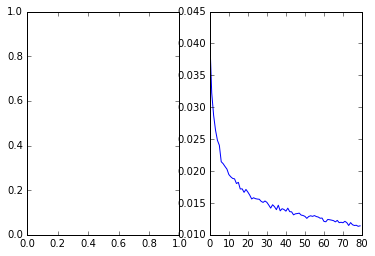

In [39]:
# actual training (fine-tuning)
import pdb
import time
import sys

ALL_LOC_PARAMS = 49*8 ### only on localization params

tr_indices  = np.array(range(len(training_list)))
vl_indices  = np.array(range(len(validation_list)))
tst_indices = np.array(range(len(test_list)))

pair_loc_loss = np.zeros((BATCH_SIZE, SEQ_LEN, ALL_LOC_PARAMS), dtype = 'float32')

input_var = T.tensor3('inputs')
target_var = T.fmatrix('targets')
weight_var_s = T.fmatrix('masks_s')
weight_var_w = T.fmatrix('masks_w')

conf_weight_mask = T.tensor3('cls_mask') ### based on best predicted score of every grid
pair_loc_loss = T.tensor3('pair_loc_loss')

m = np.ones((BATCH_SIZE, FEAT_SIZE), dtype='float32')

## one for obly object detection at for the final step and the other one for the over-all loss
if RNN_TYPE == 0: # 0 => vanilla RNN
    s_net, w_net = build_RNN_network()
elif RNN_TYPE == 1:  ##  1 => LSTM
    s_net, w_net = build_LSTM_network()
elif RNN_TYPE == 2:    # 2 => GRU  
    s_net, w_net = build_GRU_network()
else :
    print 'Wrong choice of RNN architecture' 
    sys.exit(1)

############################################
# with open('RNN_model.pkl', 'rb') as f:    
#     s_net = pickle.load(f)
############################################

base_lr = 0.01
initial_factor = 1 #0.1  # initial_factor = 0.1 if nesterov; 
learning_rate1 = base_lr * initial_factor #0.001  #0.001
learning_rate2 = base_lr * initial_factor #0.001  #0.001

lambda_wgt = 0.2   ### tradeoff between intra-sequence variation loss and final detection loss
lambda_wgt2 = 1e-06 #0.1  ### weight for localization smoothness across two consecutive frames
lambda_wgt3 = 0.1  ### weight for input-output similarity at every time-step

##########################################################################################################
obj_prediction, all_prediction = lasagne.layers.get_output( [s_net['obj_det_output'], s_net['all_output']], inputs = input_var) 

#### only supervised --- obj detection loss at the final pred step
s_loss = square_loss(obj_prediction, target_var)  ## object detection loss - final pred vs target
s_loss = lasagne.objectives.aggregate(s_loss, weights = weight_var_s, mode='mean')  #mode='normalized_sum'

s_params   = lasagne.layers.get_all_params(s_net['obj_det_output'], trainable=True)
s_updates = lasagne.updates.rmsprop(s_loss, s_params, learning_rate=learning_rate1, rho=0.9, epsilon=1e-06)
predict_supervised_fn = theano.function([input_var], obj_prediction)
train_supervised_fn = theano.function([input_var, target_var, weight_var_s], s_loss, updates = s_updates )
val_supervised_fn   = theano.function([input_var, target_var, weight_var_s], s_loss )

############################################################################################
### weakly supervised  #######
w_prediction = lasagne.layers.get_output( w_net['all_output'], inputs = input_var)
w_prediction_val = lasagne.layers.get_output( w_net['all_output'], inputs = input_var, deterministic = True)

## input-output dissimilarity loss
auto_enc_cls_loss, auto_enc_loc_loss = auto_encoder_loss(input_var, w_prediction, conf_weight_mask)
auto_enc_loss  = lasagne.objectives.aggregate(auto_enc_cls_loss, mode='mean') 
auto_enc_loss += lasagne.objectives.aggregate(auto_enc_loc_loss, mode='mean')                

#### weak-supervision at category level
stat_target = calc_target_stats(target_var)
seq_smoothness_loss = smoothness_stats(w_prediction, conf_weight_mask, stat_target)
seq_smoothness_loss = lasagne.objectives.aggregate(seq_smoothness_loss, mode='mean')  #mode='normalized_sum'

### pair-wise locatization inconsistency loss
loc_consistency_loss = localization_smoothness(w_prediction, conf_weight_mask, pair_loc_loss)
loc_consistency_loss = lasagne.objectives.aggregate(seq_smoothness_loss, mode='mean') 

## object-detection-loss at the final time-step output 
w_obj_loss = square_loss(w_prediction[:,-1,:], target_var)
w_obj_loss = lasagne.objectives.aggregate(w_obj_loss, weights = weight_var_w, mode='mean')  #mode='normalized_sum'

w_loss = lambda_wgt*seq_smoothness_loss + (1-lambda_wgt)*w_obj_loss + lambda_wgt2*loc_consistency_loss + lambda_wgt3*auto_enc_loss 

all_params   = lasagne.layers.get_all_params(w_net['all_output'], trainable=True)
all_updates  = lasagne.updates.rmsprop(w_loss, all_params, learning_rate=learning_rate2, rho=0.9, epsilon=1e-06)
predict_wsupervised_fn = theano.function([input_var], w_prediction) 
predict_val_wsupervised_fn = theano.function([input_var], w_prediction_val) 
train_weakly_supervised_fn = theano.function([input_var, target_var, weight_var_w, conf_weight_mask], w_loss, updates = all_updates )
val_weakly_supervised_fn   = theano.function([input_var, target_var, weight_var_w, conf_weight_mask], w_loss )
#########################################################################################################

print("Starting training...")
train_supervised_error, train_weakly_supervised_error, val_supervised_error, val_weakly_supervised_error = [], [], [], []    
for epoch in range(num_epochs):    

    train_serr, train_werr, train_batches = 0, 0, 0
    start_time = time.time()    
    
    print("Running Epoch {} ".format(epoch + 1) )  
               
    for batch in iterate_detection_minibatches(tr_indices, BATCH_SIZE, shuffle = True):     
        inputs = det_features(training_list, fl_to_featmap_index, batch, SEQ_LEN)     
        targets = det_detection_truth(fl_to_featmap_index, training_list, batch)                          
                
        w_obj_p = predict_wsupervised_fn(inputs)    
        
        targets, masks_w   = create_compatible_label_masks(w_obj_p[:,-1,:], targets)        
        cls_mask = create_confidence_weight_mask(inputs)
        
        werr = train_weakly_supervised_fn(inputs, targets, masks_w, cls_mask)   
        train_werr += werr
        train_batches += 1  #print 'after a mini-batch'
        
    # And a full pass over the validation data:
#     val_serr, val_werr, val_batches = 0, 0, 0
#     for batch in iterate_detection_minibatches(vl_indices, BATCH_SIZE, shuffle=False):
#         inputs = det_features(validation_list, fl_to_featmap_index, batch, SEQ_LEN)     #det_features_from_dense1  
#         targets = det_detection_truth(fl_to_featmap_index, validation_list, batch, False, True)        
        
#         w_obj_p = predict_val_wsupervised_fn(inputs)  

#         targets, masks_w   = create_compatible_label_masks(w_obj_p[:,-1,:], targets) 
#         cls_mask = create_confidence_weight_mask(inputs)
#         werr       = val_weakly_supervised_fn(inputs, targets, masks_w, cls_mask)
#         val_werr +=werr
#         val_batches += 1
        
    # Then we print the results for this epoch:
    print("Epoch {} of {} took {:.3f}s".format(epoch + 1, num_epochs, time.time() - start_time))    
    
    print("  training loss:\t\t{:.6f} - \t\t{:.6f}".format( (train_serr / train_batches),(train_werr / train_batches) ) )
    #     print("  validation loss:\t\t{:.6f} - \t\t{:.6f}".format( (val_serr / val_batches), (val_werr / val_batches) ) )
    
    train_weakly_supervised_error.append(train_werr / train_batches)    
#    val_weakly_supervised_error.append(val_werr / val_batches) 
    
     
### plot training and validation loss 
plt.figure() 
plt.subplot(1,2,1)  

x = np.arange(0, num_epochs)

plt.subplot(1,2,2)  
plt.plot(x, train_weakly_supervised_error, '-b', label='training_werror')
#plt.plot(x,   val_weakly_supervised_error, '-r', label='validation_werror')
  
# # After training, we compute and print the test error:
test_serr, test_werr, test_batches = 0, 0, 0
for batch in iterate_detection_minibatches(tst_indices, BATCH_SIZE, shuffle=False):
    inputs = det_features(test_list, ts_fl_to_featmap_index, batch, SEQ_LEN, False)        
    targets = det_detection_truth(ts_fl_to_featmap_index, test_list, batch, False, False) 
    
    w_obj_p = predict_val_wsupervised_fn(inputs)   
    
    targets, masks_w   = create_compatible_label_masks(w_obj_p[:,-1,:], targets) 
    cls_mask           = create_confidence_weight_mask(inputs)
    werr              = val_weakly_supervised_fn(inputs, targets, masks_w, cls_mask)
    test_werr         += werr
    test_batches      += 1
print("Final results:")
print("  test loss:\t\t\t{:.6f} \t\t\t{:.6f}".format( (test_serr / test_batches), (test_werr / test_batches) ))


with open('RNN_w_model.pkl', 'wb') as f:    ## X_train_labels.pkl
    pickle.dump(w_net, f, -1)   #print Y_labels

[[ 149.    0.  147.  150.    0.    0.  458.   88.    0.  224.    0.   79.
   343.   67.    0.    0.    0.    0.   93.    0.]]
[[ 180.    0.  162.  222.    0.    0.  554.  165.    0.  273.    0.  172.
   395.  195.    0.    0.    0.    0.  158.    0.]]
[[ 82.77777778          nan  90.74074074  67.56756757          nan
           nan  82.67148014  53.33333333          nan  82.05128205
           nan  45.93023256  86.83544304  34.35897436          nan
           nan          nan          nan  58.86075949          nan]]
68.5127591064


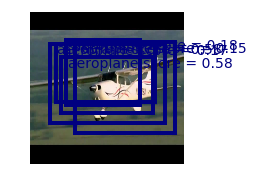

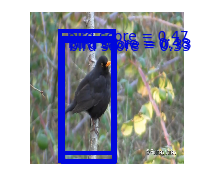

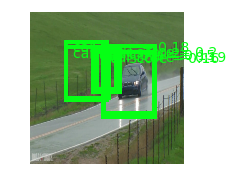

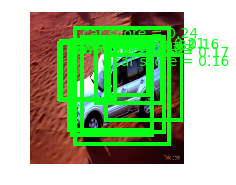

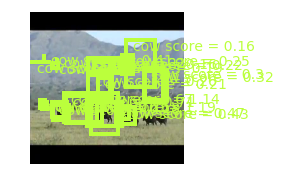

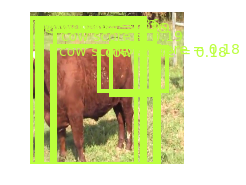

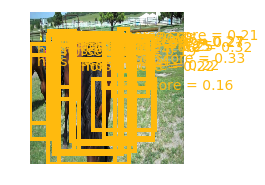

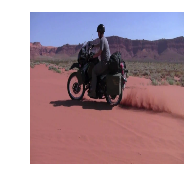

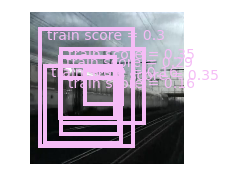

In [40]:
with open('X_test_RNN_ip_feats.pkl', 'rb') as f:    
    X_feats = pickle.load(f)            
with open('Y_test_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
    Y_labels = pickle.load(f)   #print Y_labels

with open('GRU_w_model.pkl', 'wb') as f:    ## X_train_labels.pkl
    pickle.dump(w_net, f, -1)   #print Y_labels
    
visualize_random_frames = 1

colormap = plt.cm.gist_ncar
colors = [colormap(j) for j in np.linspace(0, 1, 20)]
draw_box_list = []

basic_path = 'Youtube/'
rand_test_num = [5, 200, 500, 800, 1000, 1100, 1400, 1600, 1780]

det_cases = np.zeros((20), dtype='int')
gt_cases = np.zeros((20), dtype='int')
det_cases_all = np.zeros((1, 20), dtype='float32')
gt_cases_all  = np.zeros((1, 20), dtype='float32')

c_inputs = np.zeros((1,SEQ_LEN,FEAT_SIZE), dtype = 'float32') 
pred = np.zeros((1,FEAT_SIZE), dtype = 'float32') 
y_lab = np.zeros((1, 1225), dtype = 'float32') 

score_thresh = 0.15
for l in np.arange(len(test_list)):
    key_name = test_list[l]['GT_im_name']
    ft_idx = ts_fl_to_featmap_index[key_name]
    
    if(test_overfit == 0):
        c_inputs[0,0:SEQ_LEN,:] = X_feats[ft_idx, 0:SEQ_LEN, :]
    else:
        c_inputs[0,0:SEQ_LEN,:] = X_feats[ft_idx, -1, :] 

    obj_p = predict_val_wsupervised_fn(c_inputs) 
    pred[0,:], y_lab[0,:] = obj_p[:,-1,:], Y_labels[ft_idx, :]

    det_cases, gt_cases = detect_accuracy(pred, y_lab)
    det_cases_all = np.add(det_cases, det_cases_all)
    gt_cases_all  = np.add(gt_cases, gt_cases_all) 
    ######################################################
    if (visualize_random_frames == 1):
        if (l in rand_test_num):                      
            curr_num = test_list[l]['frame_num']       
            cat_name = test_list[l]['cat_type']

            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape 
            h, w, c = rawim.shape

            ## quick test - if the extracted cnn features are good
            #pred[0,:] = X_feats[ft_idx, -1, :]
            ##############################################

            boxes, probs = convert_YOLO_det(np.transpose(pred), 20, 2, score_thresh, 7, 1, 0)
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh)

            plt.figure( )            
            plt.subplot(1,2,1)   
            plt.imshow(rawim.astype('uint8')) 

            for box in draw_box_list:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))

                #print voc_name[category]

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
    #######################################################
    
print det_cases_all
print gt_cases_all
AP =  np.divide(det_cases_all, gt_cases_all) 
mAP = np.nansum(AP)/10
print AP*100
print mAP*100

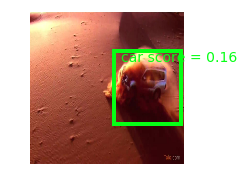

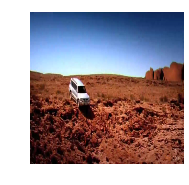

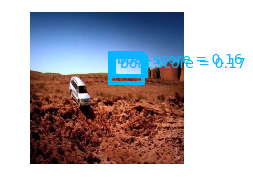

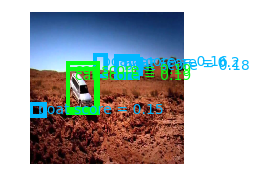

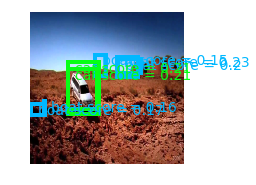

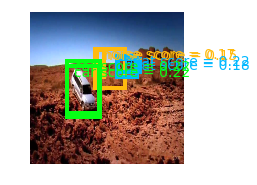

In [49]:
###### Problems #######

with open('X_test_RNN_ip_feats.pkl', 'rb') as f:    
    X_feats = pickle.load(f)            
with open('Y_test_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
    Y_labels = pickle.load(f)   #print Y_labels

colormap = plt.cm.gist_ncar
colors = [colormap(j) for j in np.linspace(0, 1, 20)]
draw_box_list = []

basic_path = 'Youtube/'
rand_test_num = [717, 718, 719, 720, 721, 722]  ### the wrong boat (car) sequence
#rand_test_num = [450, 550, 650, 750, 850, 950, 1050, 1150]

c_inputs = np.zeros((1,SEQ_LEN,FEAT_SIZE), dtype = 'float32') 
pred = np.zeros((1,FEAT_SIZE), dtype = 'float32') 
y_lab = np.zeros((1, 1225), dtype = 'float32') 

score_thresh = 0.1
for l in np.arange(len(test_list)): 
    if (l in rand_test_num):
        key_name = test_list[l]['GT_im_name']
        ft_idx = ts_fl_to_featmap_index[key_name]
        c_inputs[0,:,:] = X_feats[ft_idx, :, :]
        obj_p = predict_val_wsupervised_fn(c_inputs) 
        pred[0,:], y_lab[0,:] = obj_p[:,-1,:], Y_labels[ft_idx, :]

        curr_num = test_list[l]['frame_num']       
        cat_name = test_list[l]['cat_type']

        file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'
        rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape 
        h, w, c = rawim.shape

        boxes, probs = convert_YOLO_det(np.transpose(pred), 20, 2, score_thresh, 7, 1, 0)
        draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh)

        plt.figure( )            
        plt.subplot(1,2,1)   
        plt.imshow(rawim.astype('uint8')) 

        for box in draw_box_list:
            x = box['left']
            y = box['top']
            w = box['right'] - box['left']
            h = box['bottom'] - box['top']
            category = box['category']
            confidence = float("{0:.2f}".format(box['confidence']))

            #print voc_name[category]

            plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
            rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
            plt.gca().add_patch(rect)
            plt.draw()
        plt.axis('off') 
    #######################################################

In [65]:
input_var = T.tensor3('inputs')
target_var = T.fmatrix('targets')
############################################
with open('RNN_w_model.pkl', 'rb') as f:    
    w_net = pickle.load(f) 
############################################
w_prediction = lasagne.layers.get_output( w_net['all_output'], inputs = input_var)
w_prediction_val = lasagne.layers.get_output( w_net['all_output'], inputs = input_var, deterministic = True)
predict_val_wsupervised_fn = theano.function([input_var], w_prediction_val) 

with open('X_test_RNN_ip_feats.pkl', 'rb') as f:    
    X_feats = pickle.load(f)            
with open('Y_test_labels.pkl', 'rb') as f:    ## X_train_labels.pkl
    Y_labels = pickle.load(f)   #print Y_labels

voc_name = ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair',
             'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant',
             'sheep', 'sofa', 'train', 'tvmonitor']
SEQ_LEN = 30
FEAT_SIZE = 1470

In [148]:
import pickle
import pdb
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def non_max_suppression_slow(boxes, overlapThresh):    
    num_classes = 1
    NMS_boxes = []
    num_boxes = len(boxes)
    if(num_boxes == 0):
        return []
    x1 = np.zeros((num_classes,num_boxes))
    x2 = y1 = y2 = x1
        
    pick = []  
    #pdb.set_trace()   
    for p in np.arange(0, num_boxes):
        category = 0 #boxes[p]['category']  
        x1[category, p] = boxes[p]['left']  
        y1[category,p] = boxes[p]['top']  
        x2[category, p] = boxes[p]['right'] 
        y2[category, p] = boxes[p]['bottom']
        
    for l in np.arange(0, num_classes):
    
        area = ( x2[l,:] - x1[l,:] + 1) * (y2[l,:] - y1[l,:] + 1)
        idxs = np.argsort(y2[l,:])
    
        while len(idxs) > 0:
            last = len(idxs) -1
            i = idxs[last]
            pick.append(i)            
            suppress = [last]            
            for pos in xrange(0, last):
                j = idxs[pos]
                xx1 = np.maximum(x1[l,i], x1[l,j])
                yy1 = np.maximum(y1[l,i], y1[l,j])
                xx2 = np.maximum(x2[l,i], x2[l,j])
                yy2 = np.maximum(y2[l,i], y2[l,j])

                w = np.maximum(0, xx2 - xx1 + 1)
                h = np.maximum(0, yy2 - yy1 + 1)

                overlap = float(w*h) / area[j]

                if overlap > overlapThresh :
                    suppress.append(pos)                    
            idxs = np.delete(idxs, suppress)
    
    #print len(pick)
    for p in np.arange(0, len(pick)):
        NMS_boxes.append(boxes[pick[p]])
    
    return NMS_boxes

#####################################################################

def non_max_suppression_fast(boxes, overlapThresh):    
    num_classes = 1
    NMS_boxes = []
    num_boxes = len(boxes)
    if(num_boxes == 0):
        return []
    x1 = np.zeros((num_classes,num_boxes))
    x2 = y1 = y2 = x1
        
    pick = []  
    #pdb.set_trace()   
    for p in np.arange(0, num_boxes):
        category = 0 #boxes[p]['category']  
        x1[category, p] = boxes[p]['left']  
        y1[category,p] = boxes[p]['top']  
        x2[category, p] = boxes[p]['right'] 
        y2[category, p] = boxes[p]['bottom']
    
    
    for l in np.arange(0, num_classes):
    
        area = ( x2[l,:] - x1[l,:] + 1) * (y2[l,:] - y1[l,:] + 1)
        idxs = np.argsort(y2[l,:])
    
        while len(idxs) > 0:
            last = len(idxs) -1
            i = idxs[last]
            pick.append(i)

            xx1 = np.maximum(0, x1[l,i], x1[l,idxs[:last]])
            yy1 = np.maximum(0, y1[l,i], y1[l,idxs[:last]])
            xx2 = np.maximum(0, x2[l,i], x2[l,idxs[:last]])
            yy2 = np.maximum(0, y2[l,i], y2[l,idxs[:last]])

            w = np.maximum(0, xx2 - xx1 + 1)
            h = np.maximum(0, yy2 - yy1 + 1)

            overlap = (w*h) / area[idxs[:last]]

            ## delete all indices from the index list
            idxs = np.delete(idxs, np.concatenate(([last],
                                                  np.where(overlap > overlapThresh)[0])))
    
    #print len(pick)
    for p in np.arange(0, len(pick)):
        NMS_boxes.append(boxes[pick[p]])
    
    return NMS_boxes
        

test sequence = 718
frame num = 2
pseudo-labeler result => category bird ; confidence 0.18
Our result => category bird ; confidence 0.15
frame num = 3
pseudo-labeler result => category bird ; confidence 0.18
Our result => category bird ; confidence 0.15
frame num = 4
pseudo-labeler result => category dog ; confidence 0.23
Our result => category bird ; confidence 0.16
test sequence = 722
frame num = 0
pseudo-labeler result => category boat ; confidence 0.27
Our result => category car ; confidence 0.22
frame num = 1
pseudo-labeler result => category boat ; confidence 0.35
Our result => category car ; confidence 0.22
frame num = 2
pseudo-labeler result => category boat ; confidence 0.42
Our result => category car ; confidence 0.22
frame num = 3
pseudo-labeler result => category boat ; confidence 0.42
Our result => category car ; confidence 0.21
frame num = 4
pseudo-labeler result => category boat ; confidence 0.42
test sequence = 1680
frame num = 0
pseudo-labeler result => category train 

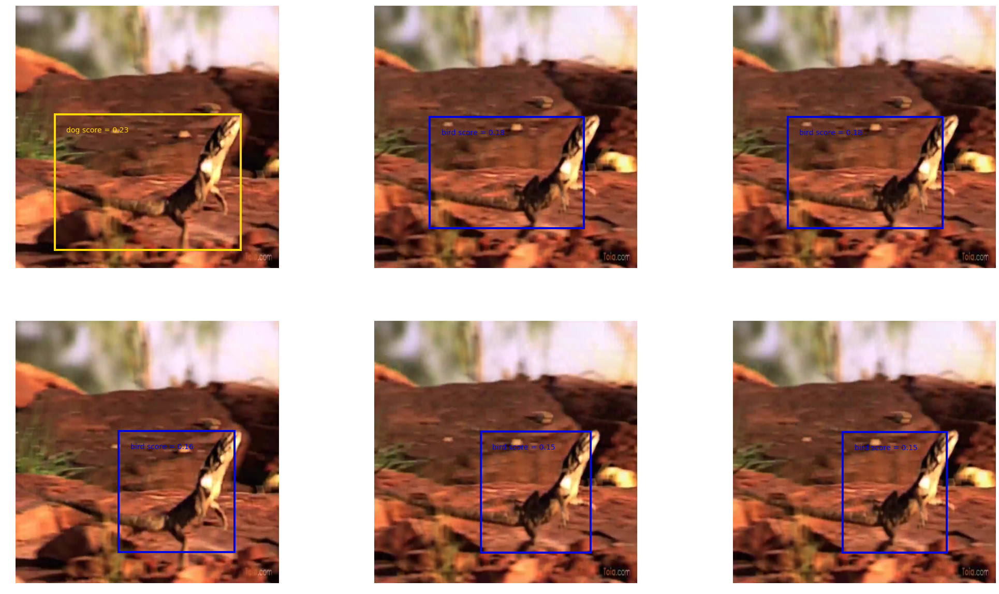

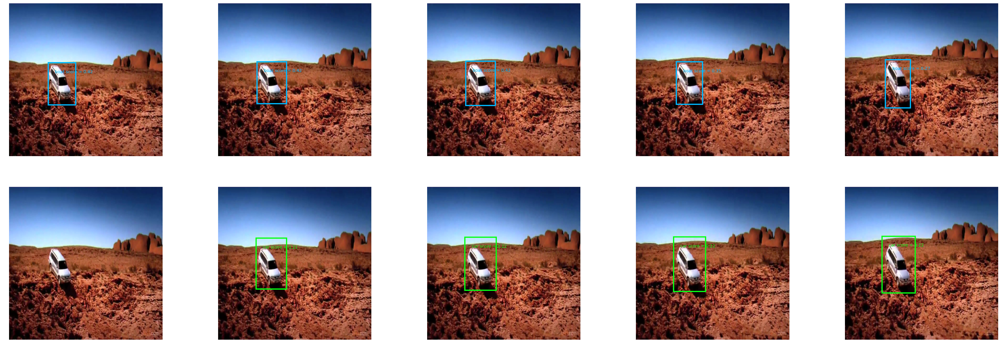

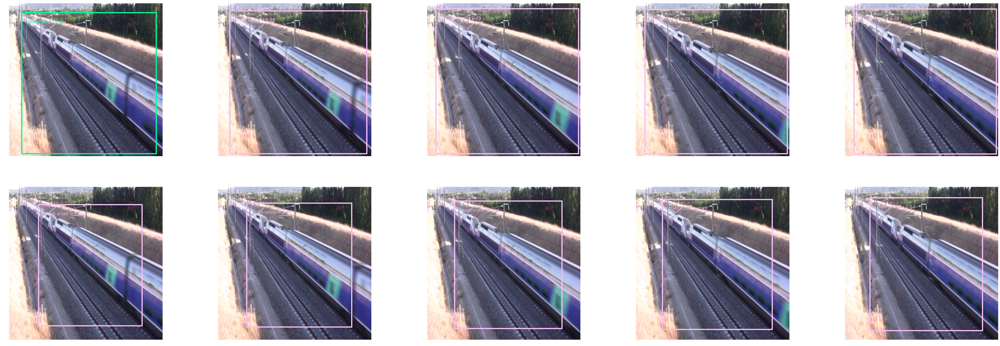

In [167]:
### more examples  
TEST_SEQ_LEN = 5
overlapThresh = 0.01
    
colormap = plt.cm.gist_ncar
colors = [colormap(j) for j in np.linspace(0, 1, 20)]
draw_box_list = []

basic_path = 'Youtube/'

#rand_test_num = [315, 415, 515, 615, 715, 815, 915, 1015, 1115, 1215, 1315, 1415, 1515, 1615, 1715]
rand_test_num = [115, 275, 325, 435, 710, 1115, 1215, 1575, 1680]
rand_test_num = [1680]  ## train
rand_test_num = [718]  ## unknown
rand_test_num = [9, 718, 722, 1000, 1680]  ##9
rand_test_num = [718, 722, 1680]  ##9

c_inputs = np.zeros((1,SEQ_LEN,FEAT_SIZE), dtype = 'float32') 
pred = np.zeros((1,FEAT_SIZE), dtype = 'float32') 
pseudo = np.zeros((1,FEAT_SIZE), dtype = 'float32') 

score_thresh = 0.2 #0.13
for l in np.arange(len(test_list)): 
    if (l in rand_test_num):
        
        score_thresh = 0.2
        overlapThresh = 0.1
        
        print 'test sequence = {}'.format(l)
        
        key_name = test_list[l]['GT_im_name']
        ft_idx = ts_fl_to_featmap_index[key_name]
        c_inputs[0,:,:] = X_feats[ft_idx, :, :]
        
        obj_p = predict_val_wsupervised_fn(c_inputs) 
       
        fr_num = test_list[l]['frame_num']       
        cat_name = test_list[l]['cat_type']
        
        start_idx = 0
        if(l == 718):
            start_idx = 2
            score_thresh = 0.13

        plt.figure(figsize=(60, 20) )
        #plt.figure()
        
        if l == 8 | l == 9 | l == 1000:
            score_thresh = 0.1
            
        for j in np.arange(start_idx,TEST_SEQ_LEN):            
            print 'frame num = {}'.format(j)
            
            curr_num = int(fr_num) - j        
            curr_num = "%08d" % (curr_num,) 
                        
            #pred[0,:] = obj_p[:,-1,:] 
            pred[0,:] = obj_p[:,SEQ_LEN - j - 1,:] 
            pseudo[0,:] = c_inputs[0, SEQ_LEN - j - 1, :]

            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape 
            h, w, c = rawim.shape
            
            #### output of pseudo-labeler
            boxes, probs = convert_YOLO_det(np.transpose(pseudo), 20, 2, score_thresh, 7, 1, 0)           
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh) 
            if(l == 8 | l == 9 | l ==1000):
                #draw_box_list1 = non_max_suppression_fast(draw_box_list, overlapThresh)
                draw_box_list1 = draw_box_list 
            else: 
                draw_box_list1 = non_max_suppression_fast(draw_box_list, overlapThresh)
                           
            
            #### output of RNN
            boxes, probs = convert_YOLO_det(np.transpose(pred), 20, 2, score_thresh, 7, 1, 0)           
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh)
            if(l == 8 | l == 9 | l == 1000):
                #draw_box_list2 = non_max_suppression_fast(draw_box_list, overlapThresh)
                draw_box_list2 = draw_box_list 
            else: 
                draw_box_list2 = non_max_suppression_fast(draw_box_list, overlapThresh)

            #plt.figure( )            
            plt.subplot(2,TEST_SEQ_LEN,TEST_SEQ_LEN - j)   
            plt.imshow(rawim.astype('uint8')) 

            #for box in draw_box_list:
            for box in draw_box_list1:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))

                print 'pseudo-labeler result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
            
            #plt.figure( )   
            plt.subplot(2,TEST_SEQ_LEN, TEST_SEQ_LEN + TEST_SEQ_LEN - j )   
            plt.imshow(rawim.astype('uint8')) 
            for box in draw_box_list2:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))
                
                print 'Our result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
    #######################################################

test sequence = 9
frame num = 0
pseudo-labeler result => category aeroplane ; confidence 0.46
pseudo-labeler result => category aeroplane ; confidence 0.47
pseudo-labeler result => category aeroplane ; confidence 0.24
pseudo-labeler result => category aeroplane ; confidence 0.59
Our result => category aeroplane ; confidence 0.62
Our result => category aeroplane ; confidence 0.61
frame num = 1
pseudo-labeler result => category aeroplane ; confidence 0.45
pseudo-labeler result => category aeroplane ; confidence 0.47
pseudo-labeler result => category aeroplane ; confidence 0.24
pseudo-labeler result => category aeroplane ; confidence 0.59
Our result => category aeroplane ; confidence 0.62
Our result => category aeroplane ; confidence 0.61
frame num = 2
pseudo-labeler result => category aeroplane ; confidence 0.41
pseudo-labeler result => category aeroplane ; confidence 0.51
pseudo-labeler result => category aeroplane ; confidence 0.26
pseudo-labeler result => category aeroplane ; confiden

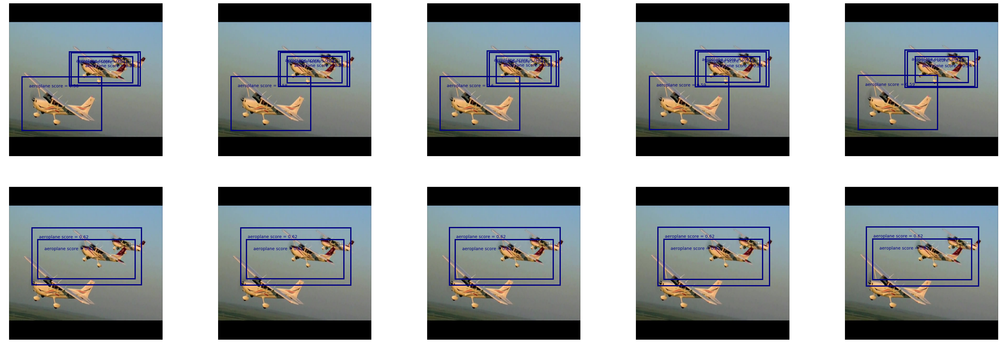

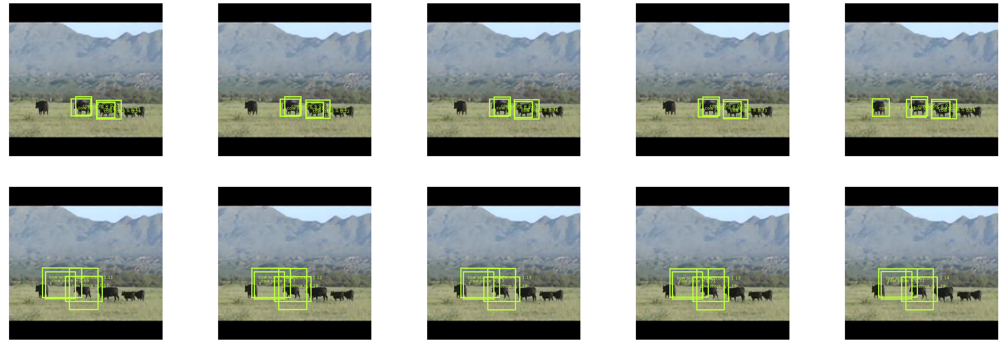

In [174]:
### more examples  
TEST_SEQ_LEN = 5
overlapThresh = 0.1
    
colormap = plt.cm.gist_ncar
colors = [colormap(j) for j in np.linspace(0, 1, 20)]
draw_box_list = []

basic_path = 'Youtube/'

#rand_test_num = [315, 415, 515, 615, 715, 815, 915, 1015, 1115, 1215, 1315, 1415, 1515, 1615, 1715]
rand_test_num = [115, 275, 325, 435, 710, 1115, 1215, 1575, 1680]
rand_test_num = [1680]  ## train
rand_test_num = [718]  ## unknown
rand_test_num = [9, 1000]  ##9

c_inputs = np.zeros((1,SEQ_LEN,FEAT_SIZE), dtype = 'float32') 
pred = np.zeros((1,FEAT_SIZE), dtype = 'float32') 
pseudo = np.zeros((1,FEAT_SIZE), dtype = 'float32') 

score_thresh = 0.15
for l in np.arange(len(test_list)): 
    if (l in rand_test_num):
        start_idx = 0
        score_thresh = 0.2
        overlapThresh = 0.1
        
        print 'test sequence = {}'.format(l)
        
        key_name = test_list[l]['GT_im_name']
        ft_idx = ts_fl_to_featmap_index[key_name]
        c_inputs[0,:,:] = X_feats[ft_idx, :, :]
        
        obj_p = predict_val_wsupervised_fn(c_inputs) 
       
        fr_num = test_list[l]['frame_num']       
        cat_name = test_list[l]['cat_type']
        
        plt.figure(figsize=(60, 20) )
        #plt.figure()

            
        for j in np.arange(start_idx,TEST_SEQ_LEN):            
            print 'frame num = {}'.format(j)
            
            curr_num = int(fr_num) - j        
            curr_num = "%08d" % (curr_num,) 
                        
            #pred[0,:] = obj_p[:,-1,:] 
            pred[0,:] = obj_p[:,SEQ_LEN - j - 1,:] 
            pseudo[0,:] = c_inputs[0, SEQ_LEN - j - 1, :]

            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape 
            h, w, c = rawim.shape
            
            #### output of pseudo-labeler
            score_thresh = 0.2
            boxes, probs = convert_YOLO_det(np.transpose(pseudo), 20, 2, score_thresh, 7, 1, 0)           
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh) 
            #draw_box_list1 = non_max_suppression_fast(draw_box_list, overlapThresh)
            draw_box_list1 = draw_box_list                         
            
            #### output of RNN
            score_thresh = 0.6
            boxes, probs = convert_YOLO_det(np.transpose(pred), 20, 2, score_thresh, 7, 1, 0)           
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh)            
            #draw_box_list2 = non_max_suppression_fast(draw_box_list, overlapThresh)
            draw_box_list2 = draw_box_list 
            

            #plt.figure( )            
            plt.subplot(2,TEST_SEQ_LEN,TEST_SEQ_LEN - j)   
            plt.imshow(rawim.astype('uint8')) 

            #for box in draw_box_list:
            for box in draw_box_list1:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))

                print 'pseudo-labeler result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
            
            #plt.figure( )   
            plt.subplot(2,TEST_SEQ_LEN, TEST_SEQ_LEN + TEST_SEQ_LEN - j )   
            plt.imshow(rawim.astype('uint8')) 
            for box in draw_box_list2:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))
                
                print 'Our result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
    #######################################################

In [274]:
import pickle
import pdb
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def non_max_suppression_slow(boxes, overlapThresh):    
    num_classes = 1
    NMS_boxes = []
    num_boxes = len(boxes)
    if(num_boxes == 0):
        return []
    x1 = np.zeros((num_classes,num_boxes))
    x2 = y1 = y2 = x1
        
    pick = []  
    #pdb.set_trace()   
    for p in np.arange(0, num_boxes):
        category = 0 #boxes[p]['category']  
        x1[category, p] = boxes[p]['left']  
        y1[category,p] = boxes[p]['top']  
        x2[category, p] = boxes[p]['right'] 
        y2[category, p] = boxes[p]['bottom']
        
    for l in np.arange(0, num_classes):
    
        area = ( x2[l,:] - x1[l,:] + 1) * (y2[l,:] - y1[l,:] + 1)
        idxs = np.argsort(y2[l,:])
    
        while len(idxs) > 0:
            last = len(idxs) -1
            i = idxs[last]
            pick.append(i)            
            suppress = [last]            
            for pos in xrange(0, last):
                j = idxs[pos]
                xx1 = np.maximum(x1[l,i], x1[l,j])
                yy1 = np.maximum(y1[l,i], y1[l,j])
                xx2 = np.maximum(x2[l,i], x2[l,j])
                yy2 = np.maximum(y2[l,i], y2[l,j])

                w = np.maximum(0, xx2 - xx1 + 1)
                h = np.maximum(0, yy2 - yy1 + 1)

                overlap = float(w*h) / area[j]

                if overlap > overlapThresh :
                    suppress.append(pos)                    
            idxs = np.delete(idxs, suppress)
    
    #print len(pick)
    for p in np.arange(0, len(pick)):
        NMS_boxes.append(boxes[pick[p]])
    
    return NMS_boxes

#####################################################################

def non_max_suppression_fast(boxes, overlapThresh):    
    num_classes = 1 #20
    NMS_boxes = []
    num_boxes = len(boxes)
    if(num_boxes == 0):
        return []
    x1 = np.zeros((num_classes,num_boxes))
    x2 = y1 = y2 = x1
        
    pick = []  
    #pdb.set_trace()   
    for p in np.arange(0, num_boxes):
        category = boxes[p]['category']  #0
        if num_classes == 1:
            category = 0
        x1[category, p] = boxes[p]['left']  
        y1[category,p] = boxes[p]['top']  
        x2[category, p] = boxes[p]['right'] 
        y2[category, p] = boxes[p]['bottom']
    
    
    for l in np.arange(0, num_classes):
    
        area = ( x2[l,:] - x1[l,:] + 1) * (y2[l,:] - y1[l,:] + 1)
        idxs = np.argsort(y2[l,:])
    
        while len(idxs) > 0:
            last = len(idxs) -1
            i = idxs[last]
            pick.append(i)

            xx1 = np.maximum(0, x1[l,i], x1[l,idxs[:last]])
            yy1 = np.maximum(0, y1[l,i], y1[l,idxs[:last]])
            xx2 = np.maximum(0, x2[l,i], x2[l,idxs[:last]])
            yy2 = np.maximum(0, y2[l,i], y2[l,idxs[:last]])

            w = np.maximum(0, xx2 - xx1 + 1)
            h = np.maximum(0, yy2 - yy1 + 1)

            overlap = (w*h) / area[idxs[:last]]

            ## delete all indices from the index list
            idxs = np.delete(idxs, np.concatenate(([last],
                                                  np.where(overlap > overlapThresh)[0])))
    
    #print len(pick)
    for p in np.arange(0, len(pick)):
        NMS_boxes.append(boxes[pick[p]])
    
    return NMS_boxes
        

test sequence = 212
frame num = 0
pseudo-labeler result => category bird ; confidence 0.37
pseudo-labeler result => category bird ; confidence 0.57
Our result => category bird ; confidence 0.28
Our result => category bird ; confidence 0.27
frame num = 1
pseudo-labeler result => category bird ; confidence 0.33
pseudo-labeler result => category bird ; confidence 0.51
Our result => category bird ; confidence 0.27
Our result => category bird ; confidence 0.27
frame num = 2
pseudo-labeler result => category bird ; confidence 0.34
pseudo-labeler result => category bird ; confidence 0.45
pseudo-labeler result => category bird ; confidence 0.2
Our result => category bird ; confidence 0.27
Our result => category bird ; confidence 0.26
frame num = 3
pseudo-labeler result => category bird ; confidence 0.36
pseudo-labeler result => category bird ; confidence 0.47
Our result => category bird ; confidence 0.26
Our result => category bird ; confidence 0.25
frame num = 4
Our result => category bird ; 

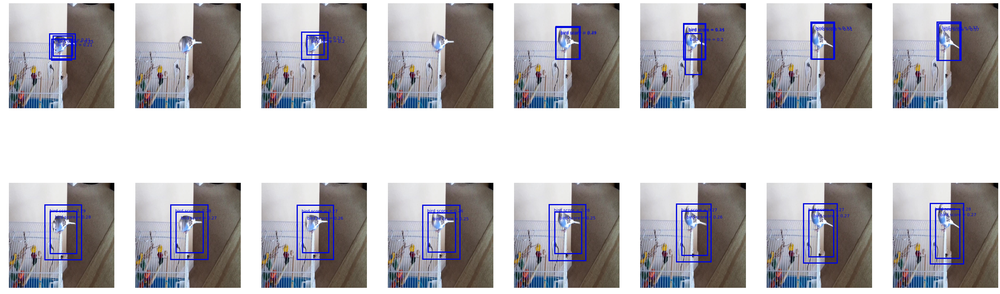

In [393]:
### more examples  
TEST_SEQ_LEN = 8
overlapThresh = 0.01
    
colormap = plt.cm.gist_ncar
colors = [colormap(j) for j in np.linspace(0, 1, 20)]
draw_box_list = []

basic_path = 'Youtube/'

rand_test_num = [212, 670, 707,873,874,1240, 1287, 1483]  #1306, 1337, 1286, 575; 519; 1041 <1001>
rand_test_num = [212]  

c_inputs = np.zeros((1,SEQ_LEN,FEAT_SIZE), dtype = 'float32') 
pred = np.zeros((1,FEAT_SIZE), dtype = 'float32') 
pseudo = np.zeros((1,FEAT_SIZE), dtype = 'float32') 

score_thresh = 0.2 #0.13
for l in np.arange(len(test_list)): 
    if (l in rand_test_num):
        
        score_thresh = 0.1
        overlapThresh = 0.4
        
        print 'test sequence = {}'.format(l)
        
        key_name = test_list[l]['GT_im_name']
        ft_idx = ts_fl_to_featmap_index[key_name]
        c_inputs[0,:,:] = X_feats[ft_idx, :, :]
        
        obj_p = predict_val_wsupervised_fn(c_inputs) 
       
        fr_num = test_list[l]['frame_num']       
        cat_name = test_list[l]['cat_type']
        
        start_idx = 0
        plt.figure(figsize=(60, 20) )
        #plt.figure()
                    
        for j in np.arange(start_idx,TEST_SEQ_LEN):            
            print 'frame num = {}'.format(j)
            
            curr_num = int(fr_num) - j        
            curr_num = "%08d" % (curr_num,) 
                        
            #pred[0,:] = obj_p[:,-1,:] 
            pred[0,:] = obj_p[:,SEQ_LEN - j - 1,:] 
            pseudo[0,:] = c_inputs[0, SEQ_LEN - j - 1, :]

            file_name = basic_path + 'allImages/' + cat_name + '/' + curr_num + '.jpg'
            rawim, im = prep_image_from_name(file_name, 'jpg')  #             h, w, c = rawim.shape 
            h, w, c = rawim.shape
            
            #### output of pseudo-labeler
            score_thresh = 0.2
            overlapThresh = 0.3
            boxes, probs = convert_YOLO_det(np.transpose(pseudo), 20, 2, score_thresh, 7, 1, 0)           
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh) 
            draw_box_list1 = draw_box_list
            #draw_box_list1 = non_max_suppression_fast(draw_box_list, overlapThresh)
                           
            
            #### output of RNN
            score_thresh = 0.2
            overlapThresh = 0.2
            boxes, probs = convert_YOLO_det(np.transpose(pred), 20, 2, score_thresh, 7, 1, 0) 
            draw_box_list = draw_detection_bbox(49*2, probs, boxes, 20, 2, w, h, score_thresh)
            draw_box_list2 = draw_box_list
            #draw_box_list2 = non_max_suppression_fast(draw_box_list, overlapThresh)

            #plt.figure( )            
            plt.subplot(2,TEST_SEQ_LEN,TEST_SEQ_LEN - j)   
            plt.imshow(rawim.astype('uint8')) 

            #for box in draw_box_list:
            for box in draw_box_list1:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))

                print 'pseudo-labeler result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
            
            #plt.figure( )   
            plt.subplot(2,TEST_SEQ_LEN, TEST_SEQ_LEN + TEST_SEQ_LEN - j )   
            plt.imshow(rawim.astype('uint8')) 
            for box in draw_box_list2:
                x = box['left']
                y = box['top']
                w = box['right'] - box['left']
                h = box['bottom'] - box['top']
                category = box['category']
                confidence = float("{0:.2f}".format(box['confidence']))
                
                print 'Our result => category {} ; confidence {}'.format(voc_name[category], confidence)
                #print voc_name[category], confidence, '\t'

                plt.text(x+20, y+30, '{} score = {}'.format(voc_name[category], confidence), fontsize=14, color=colors[category])
                rect = plt.Rectangle((x,y), w, h, edgecolor=colors[category], facecolor="none", fill=False, linewidth = 4)
                plt.gca().add_patch(rect)
                plt.draw()
            plt.axis('off') 
    #######################################################